In [ ]:
"""
    Image segmentation example
    More models on https://huggingface.co/models?pipeline_tag=image-segmentation&sort=downloads
    Use SHIFT + ENTER to execute block of code!!!
"""

In [16]:
from transformers import pipeline, SegformerFeatureExtractor, SegformerForSemanticSegmentation, SegformerImageProcessor, MaskFormerImageProcessor
from PIL import Image, ImageDraw, ImageOps

import torch
import numpy as np
import torch.nn as nn
import matplotlib.pyplot as plt

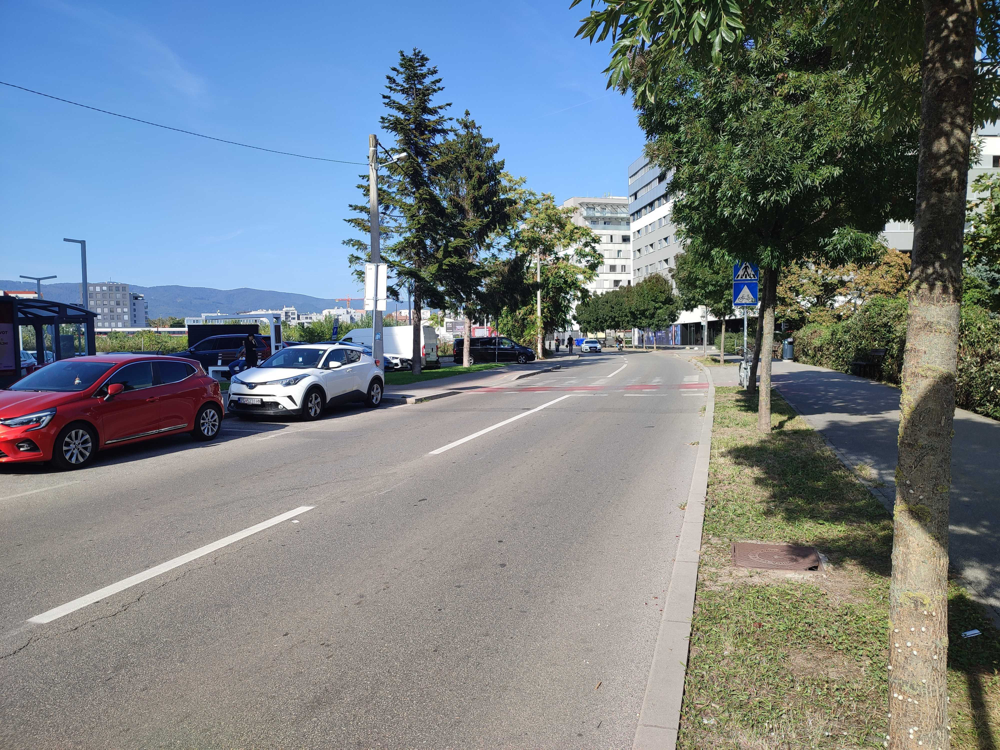

In [18]:
"""
    Show image
"""
Image.open(r"./images/ZG.jpeg") 

In [20]:
image = Image.open(r"./images/ZG.jpeg")
pipe = pipeline("image-segmentation", model="nvidia/segformer-b5-finetuned-cityscapes-1024-1024")
pipe_result = pipe(image)
for result in pipe_result:
    print(result)

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.


{'score': None, 'label': 'road', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC3340>}
{'score': None, 'label': 'sidewalk', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC3280>}
{'score': None, 'label': 'building', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC31F0>}
{'score': None, 'label': 'fence', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC3370>}
{'score': None, 'label': 'pole', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC31C0>}
{'score': None, 'label': 'traffic light', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC3220>}
{'score': None, 'label': 'traffic sign', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC3160>}
{'score': None, 'label': 'vegetation', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BDC33A0>}
{'score': None, 'label': 'terrain', 'mask': <PIL.Image.Image image mode=L size=4000x3000 at 0x17BD09F40>}
{'score': None, 'label': 'sky', 'mask'

In [28]:
def change_opacity(image):
    image.putalpha(128)

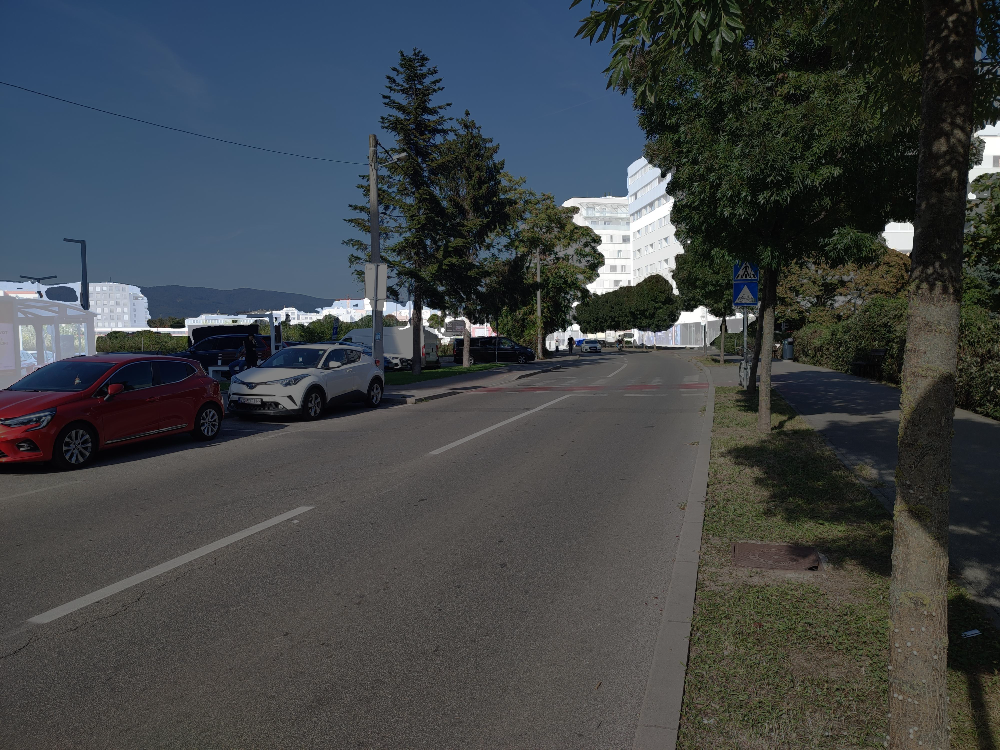

In [30]:
image = Image.open(r"./images/ZG.jpeg")
building_mask = pipe_result[2]['mask']
change_opacity(building_mask)
building_mask.convert("RGB")
image.paste(building_mask, (0,0), mask=building_mask) 
image

In [25]:
image = Image.open(r"./images/ZG.jpeg")

processor = SegformerImageProcessor.from_pretrained("nvidia/segformer-b5-finetuned-cityscapes-1024-1024")
model = SegformerForSemanticSegmentation.from_pretrained("nvidia/segformer-b5-finetuned-cityscapes-1024-1024")

inputs = processor(image, return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)

/var/folders/s6/nq5g7b495vj060rblsg0tz6c0000gn/T/ipykernel_9456/724010002.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  viridis = cm.get_cmap('viridis', torch.max(segmentation))


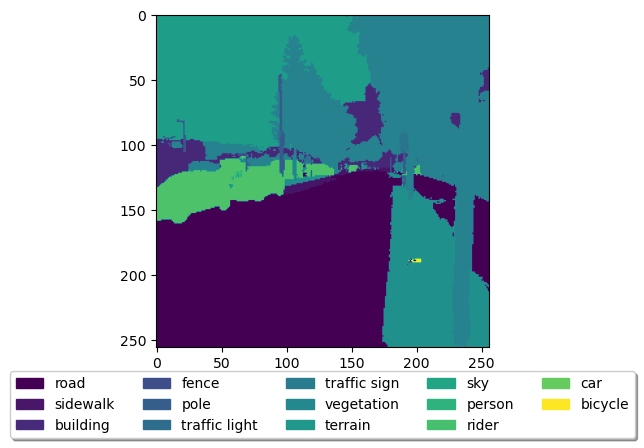

In [26]:
"""
    Post processing
"""

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from matplotlib import cm

def draw_semantic_segmentation(segmentation):
    viridis = cm.get_cmap('viridis', torch.max(segmentation))
    labels_ids = torch.unique(segmentation).tolist()
    fig, ax = plt.subplots()
    
    # Shrink current axis's height by 10% on the bottom
    box = ax.get_position()
    ax.set_position([box.x0, box.y0 + box.height * 0.1,
                     box.width, box.height * 0.9])
     
    ax.imshow(segmentation)
    handles = []
    for label_id in labels_ids:
        label = model.config.id2label[label_id]
        color = viridis(label_id)
        handles.append(mpatches.Patch(color=color, label=label))
        
    # Put a legend below current axis
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
              fancybox=True, shadow=True, ncol=5, handles=handles)
    return fig

semantic_segmentation = processor.post_process_semantic_segmentation(outputs)[0]
result = draw_semantic_segmentation(semantic_segmentation)